In [1]:
from  pycaret.datasets import get_data

In [2]:
dataset = get_data('credit', profile=True)

In [3]:
dataset.shape

(24000, 24)

In [4]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions ' + str(data_unseen.shape))

Data for Modeling: (22800, 24)
Unseen Data For Predictions (1200, 24)


In [5]:
from pycaret.classification import *

In [7]:
exp_clf102 = setup(data = data, target = 'default', session_id=123,
                  normalize = True, 
                  transformation = True, 
                  ignore_low_variance = True,
                  remove_multicollinearity = True, multicollinearity_threshold = 0.95,
                  bin_numeric_features = ['LIMIT_BAL', 'AGE'],
                  group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
                                   ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
                  log_experiment = True, experiment_name = 'credit1')

,Description,Value
0,session_id,123
1,Target,default
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


# Comparing All Models

In [8]:
top3 = compare_models(n_select = 3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8256,0.0000,0.3606,0.6949,0.4745,0.3823,0.4121,0.0610
lda,Linear Discriminant Analysis,0.8243,0.7743,0.3775,0.6756,0.4842,0.3884,0.4124,0.3080
gbc,Gradient Boosting Classifier,0.8239,0.7774,0.3580,0.6863,0.4703,0.3771,0.4059,7.1180
ada,Ada Boost Classifier,0.8222,0.7734,0.3379,0.6910,0.4536,0.3621,0.3953,2.6180
catboost,CatBoost Classifier,0.8215,0.7748,0.3660,0.6673,0.4726,0.3760,0.4006,32.6370
lightgbm,Light Gradient Boosting Machine,0.8208,0.7681,0.3603,0.6670,0.4676,0.3713,0.3969,0.8260
rf,Random Forest Classifier,0.8181,0.7601,0.3514,0.6574,0.4576,0.3603,0.3860,3.0180
et,Extra Trees Classifier,0.8153,0.7519,0.3620,0.6362,0.4612,0.3598,0.3807,2.3550
xgboost,Extreme Gradient Boosting,0.8138,0.7544,0.3568,0.6313,0.4557,0.3537,0.3748,9.6180
lr,Logistic Regression,0.7866,0.6996,0.0811,0.5881,0.1423,0.0943,0.1572,2.1340


In [10]:
print(top3)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

#  Create a Model

In [11]:
dt = create_model('dt', fold = 5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7206,0.6084,0.3983,0.3707,0.3840,0.2036,0.2038
1,0.7365,0.6282,0.4327,0.4043,0.4180,0.2480,0.2482
2,0.7290,0.6197,0.4212,0.3894,0.4047,0.2296,0.2299
3,0.7278,0.6038,0.3825,0.3787,0.3806,0.2062,0.2062
4,0.7339,0.6151,0.4032,0.3936,0.3983,0.2275,0.2276
Mean,0.7296,0.6150,0.4076,0.3873,0.3971,0.2230,0.2231
SD,0.0055,0.0085,0.0176,0.0117,0.0137,0.0164,0.0165


In [12]:
rf = create_model('rf', round = 2)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.81,0.76,0.33,0.63,0.43,0.33,0.36
1,0.82,0.76,0.37,0.68,0.48,0.39,0.41
2,0.82,0.77,0.35,0.69,0.46,0.37,0.40
3,0.82,0.76,0.39,0.66,0.49,0.39,0.41
4,0.82,0.76,0.37,0.68,0.48,0.38,0.41
5,0.83,0.78,0.36,0.69,0.48,0.38,0.41
6,0.81,0.76,0.33,0.63,0.44,0.34,0.36
7,0.82,0.74,0.33,0.68,0.44,0.35,0.39
8,0.80,0.75,0.32,0.59,0.41,0.31,0.33
9,0.82,0.76,0.37,0.64,0.47,0.37,0.39


# Tune a Model

In [13]:
tuned_rf = tune_model(rf, optimize = 'AUC')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7569,0.7714,0.6562,0.4608,0.5414,0.3828,0.3939
1,0.7625,0.7659,0.6705,0.4699,0.5525,0.3977,0.4093
2,0.7538,0.7703,0.6476,0.4556,0.5349,0.3743,0.3850
3,0.7375,0.7832,0.6762,0.4354,0.5297,0.3593,0.3760
4,0.7525,0.7928,0.6734,0.4554,0.5434,0.3822,0.3959
5,0.7544,0.7807,0.6590,0.4573,0.5399,0.3798,0.3916
6,0.7256,0.7653,0.6676,0.4198,0.5155,0.3376,0.3553
7,0.7525,0.7488,0.6046,0.4509,0.5165,0.3549,0.3618
8,0.7312,0.7433,0.6189,0.4219,0.5017,0.3266,0.3379
9,0.7285,0.7592,0.6408,0.4200,0.5074,0.3311,0.3451


In [14]:
tuned_rf2 = tune_model(rf, optimize = 'Recall')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
1,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
2,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
3,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
4,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
5,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
6,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
7,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
8,0.2187,0.5000,1.0000,0.2187,0.3589,0.0000,0.0000
9,0.2182,0.5000,1.0000,0.2182,0.3582,0.0000,0.0000


In [15]:
plot_model(tuned_rf, plot = 'parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced_subsample
criterion,gini
max_depth,4
max_features,sqrt
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.0005
min_impurity_split,None


In [16]:
plot_model(tuned_rf2, plot = 'parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced
criterion,gini
max_depth,2
max_features,log2
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.1
min_impurity_split,None


# Ensemble a Model

In [17]:
dt = create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7318,0.6211,0.4212,0.3941,0.4072,0.2342,0.2344
1,0.7274,0.6259,0.4384,0.3903,0.4130,0.2363,0.2369
2,0.7437,0.6232,0.4069,0.4128,0.4098,0.2462,0.2462
3,0.7231,0.6066,0.3983,0.3747,0.3861,0.2075,0.2077
4,0.7387,0.6309,0.4327,0.4081,0.4200,0.2516,0.2518
5,0.7356,0.6126,0.3954,0.3954,0.3954,0.2262,0.2262
6,0.7281,0.6176,0.4241,0.3885,0.4055,0.2296,0.2300
7,0.7318,0.6013,0.3696,0.3828,0.3761,0.2054,0.2054
8,0.7412,0.6280,0.4269,0.4116,0.4191,0.2527,0.2528
9,0.7304,0.6145,0.4109,0.3886,0.3994,0.2258,0.2260


#  Bagging

In [18]:
bagged_dt = ensemble_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7989,0.7184,0.3209,0.5714,0.4110,0.3011,0.3193
1,0.8164,0.7319,0.3782,0.6346,0.4740,0.3713,0.3895
2,0.8102,0.7337,0.3152,0.6322,0.4207,0.3220,0.3499
3,0.8089,0.7399,0.3209,0.6222,0.4234,0.3226,0.3481
4,0.8152,0.7268,0.3209,0.6588,0.4316,0.3366,0.3677
5,0.8076,0.7464,0.3438,0.6061,0.4388,0.3332,0.3527
6,0.7976,0.7214,0.3095,0.5684,0.4007,0.2915,0.3110
7,0.8145,0.7235,0.3037,0.6667,0.4173,0.3249,0.3605
8,0.8102,0.7116,0.3209,0.6292,0.4250,0.3254,0.3519
9,0.8088,0.7214,0.3333,0.6138,0.4320,0.3290,0.3512


In [19]:
print(bagged_dt)

BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                                        presort='deprecated',
                                                        random_state=123,
 

# Boosting

In [20]:
boosted_dt = ensemble_model(dt, method = 'Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7406,0.6522,0.3668,0.3988,0.3821,0.2183,0.2186
1,0.7845,0.6764,0.4269,0.5085,0.4642,0.3306,0.3325
2,0.7820,0.6775,0.3639,0.5020,0.4219,0.2918,0.2975
3,0.7782,0.6719,0.2894,0.4879,0.3633,0.2395,0.2515
4,0.7732,0.6996,0.3009,0.4709,0.3671,0.2370,0.2459
5,0.7682,0.6597,0.3467,0.4601,0.3954,0.2555,0.2594
6,0.7657,0.6376,0.3381,0.4521,0.3869,0.2457,0.2497
7,0.7851,0.6900,0.3438,0.5128,0.4117,0.2864,0.2950
8,0.7682,0.6925,0.3897,0.4642,0.4237,0.2800,0.2816
9,0.7912,0.7258,0.3506,0.5328,0.4229,0.3020,0.3119


In [21]:
bagged_dt2 = ensemble_model(dt, n_estimators=50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8108,0.7492,0.3496,0.6193,0.4469,0.3433,0.3637
1,0.8221,0.7530,0.3954,0.6540,0.4929,0.3928,0.4111
2,0.8139,0.7560,0.3467,0.6368,0.4490,0.3485,0.3719
3,0.8102,0.7437,0.3295,0.6250,0.4315,0.3304,0.3549
4,0.8152,0.7550,0.3496,0.6421,0.4527,0.3529,0.3766
5,0.8170,0.7655,0.3582,0.6477,0.4613,0.3619,0.3849
6,0.8039,0.7548,0.3324,0.5918,0.4257,0.3185,0.3378
7,0.8202,0.7356,0.3324,0.6824,0.4470,0.3546,0.3873
8,0.8083,0.7397,0.3352,0.6126,0.4333,0.3296,0.3514
9,0.8232,0.7591,0.3793,0.6667,0.4835,0.3864,0.4088


# Blending

In [22]:
lightgbm = create_model('lightgbm', verbose = False)
dt = create_model('dt', verbose = False)
lr = create_model('lr', verbose = False)

In [23]:
blend_soft = blend_models(estimator_list = [lightgbm, dt, lr], method = 'soft')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8058,0.7385,0.3524,0.5942,0.4424,0.3340,0.3507
1,0.8014,0.7384,0.3668,0.5714,0.4468,0.3327,0.3448
2,0.8114,0.7410,0.3524,0.6212,0.4497,0.3462,0.3665
3,0.7920,0.7467,0.3467,0.5378,0.4216,0.3019,0.3127
4,0.7989,0.7719,0.3582,0.5631,0.4378,0.3227,0.3349
5,0.7907,0.7527,0.3181,0.5362,0.3993,0.2824,0.2966
6,0.7932,0.7429,0.3524,0.5419,0.4271,0.3078,0.3184
7,0.7964,0.7296,0.3066,0.5632,0.3970,0.2871,0.3064
8,0.7989,0.7384,0.3496,0.5648,0.4319,0.3178,0.3313
9,0.7918,0.7280,0.3448,0.5357,0.4196,0.3000,0.3108


In [24]:
blend_hard = blend_models(estimator_list = [lightgbm, dt, lr], method = 'hard')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8189,0.0000,0.2923,0.7083,0.4138,0.3279,0.3731
1,0.8221,0.0000,0.3295,0.6970,0.4475,0.3572,0.3929
2,0.8139,0.0000,0.2779,0.6831,0.3951,0.3075,0.3511
3,0.8120,0.0000,0.2808,0.6667,0.3952,0.3051,0.3452
4,0.8170,0.0000,0.2894,0.6966,0.4089,0.3219,0.3655
5,0.8127,0.0000,0.2693,0.6812,0.3860,0.2992,0.3442
6,0.8114,0.0000,0.2779,0.6644,0.3919,0.3019,0.3422
7,0.8102,0.0000,0.2378,0.6917,0.3539,0.2725,0.3263
8,0.8158,0.0000,0.2808,0.6950,0.4000,0.3136,0.3588
9,0.8138,0.0000,0.2960,0.6645,0.4095,0.3178,0.3546


In [25]:
blender_top3 = blend_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8183,0.0000,0.3582,0.6545,0.4630,0.3647,0.3887
1,0.8315,0.0000,0.3897,0.7083,0.5028,0.4114,0.4381
2,0.8239,0.0000,0.3467,0.6954,0.4627,0.3712,0.4034
3,0.8296,0.0000,0.3754,0.7081,0.4906,0.3997,0.4288
4,0.8221,0.0000,0.3582,0.6757,0.4682,0.3732,0.4003
5,0.8321,0.0000,0.4011,0.7035,0.5109,0.4186,0.4427
6,0.8227,0.0000,0.3639,0.6755,0.4730,0.3777,0.4039
7,0.8277,0.0000,0.3524,0.7151,0.4722,0.3831,0.4174
8,0.8202,0.0000,0.3553,0.6667,0.4636,0.3674,0.3936
9,0.8251,0.0000,0.3793,0.6769,0.4862,0.3907,0.4145


In [26]:
print(blender_top3.estimators_)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
       

# Stacking

In [27]:
stack_soft = stack_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7876,0.6892,0.1347,0.5595,0.2171,0.1445,0.1944
1,0.7888,0.6999,0.0888,0.6200,0.1554,0.1064,0.1746
2,0.7838,0.6893,0.1433,0.5208,0.2247,0.1440,0.1849
3,0.7851,0.7128,0.0860,0.5556,0.1489,0.0959,0.1525
4,0.7951,0.7260,0.1117,0.6964,0.1926,0.1406,0.2204
5,0.7895,0.7055,0.0831,0.6444,0.1472,0.1024,0.1755
6,0.7957,0.6849,0.1490,0.6420,0.2419,0.1738,0.2368
7,0.7888,0.7105,0.0659,0.6765,0.1201,0.0846,0.1634
8,0.7914,0.7121,0.0946,0.6600,0.1654,0.1170,0.1920
9,0.7850,0.6980,0.0718,0.5556,0.1272,0.0813,0.1392


In [28]:
xgboost = create_model('xgboost')
stack_soft2 = stack_models(top3, meta_model=xgboost)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8083,0.7580,0.3496,0.6070,0.4436,0.3378,0.3566
1,0.8145,0.7649,0.3868,0.6221,0.4770,0.3717,0.3872
2,0.8164,0.7652,0.3438,0.6522,0.4503,0.3525,0.3786
3,0.8252,0.7642,0.3954,0.6699,0.4973,0.3999,0.4203
4,0.8039,0.7707,0.3295,0.5928,0.4236,0.3168,0.3367
5,0.8221,0.7615,0.3811,0.6617,0.4836,0.3854,0.4068
6,0.8164,0.7602,0.3840,0.6321,0.4777,0.3743,0.3914
7,0.8177,0.7394,0.3467,0.6576,0.4540,0.3569,0.3833
8,0.8070,0.7397,0.3324,0.6073,0.4296,0.3253,0.3467
9,0.8063,0.7485,0.3649,0.5907,0.4512,0.3414,0.3560


# Model Calibration

In [29]:
rf = create_model('rf')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8108,0.7649,0.3266,0.6298,0.4302,0.3301,0.3558
1,0.8239,0.7596,0.3725,0.6771,0.4806,0.3852,0.4101
2,0.8239,0.7653,0.3496,0.6932,0.4648,0.3728,0.4042
3,0.8214,0.7575,0.3868,0.6553,0.4865,0.3870,0.4067
4,0.8233,0.7590,0.3696,0.6754,0.4778,0.3822,0.4074
5,0.8252,0.7835,0.3639,0.6902,0.4765,0.3835,0.4118
6,0.8120,0.7592,0.3324,0.6339,0.4361,0.3362,0.3615
7,0.8202,0.7383,0.3295,0.6845,0.4449,0.3529,0.3866
8,0.8033,0.7530,0.3152,0.5946,0.4120,0.3070,0.3293
9,0.8169,0.7602,0.3678,0.6400,0.4672,0.3662,0.3867


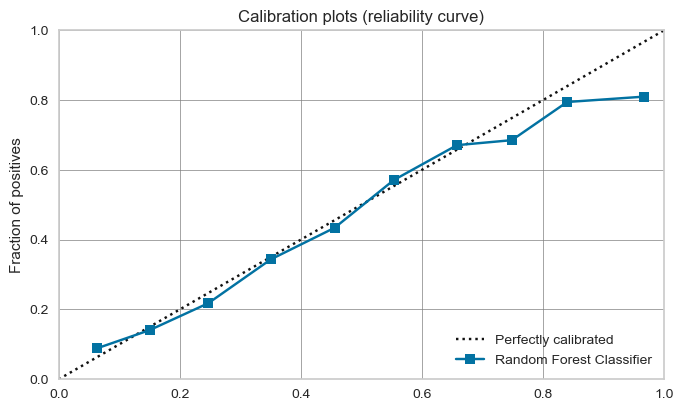

In [30]:
plot_model(rf, plot='calibration')

In [31]:
calibrated_rf = calibrate_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8108,0.7665,0.3095,0.6391,0.4170,0.3200,0.3500
1,0.8302,0.7653,0.3725,0.7143,0.4896,0.3997,0.4302
2,0.8189,0.7686,0.3037,0.6974,0.4232,0.3349,0.3757
3,0.8246,0.7653,0.3610,0.6885,0.4737,0.3805,0.4091
4,0.8195,0.7710,0.3324,0.6784,0.4462,0.3531,0.3853
5,0.8252,0.7769,0.3553,0.6966,0.4706,0.3788,0.4097
6,0.8202,0.7691,0.3324,0.6824,0.4470,0.3546,0.3873
7,0.8258,0.7521,0.3266,0.7261,0.4506,0.3643,0.4055
8,0.8139,0.7514,0.3266,0.6477,0.4343,0.3371,0.3654
9,0.8226,0.7634,0.3477,0.6836,0.4610,0.3680,0.3981


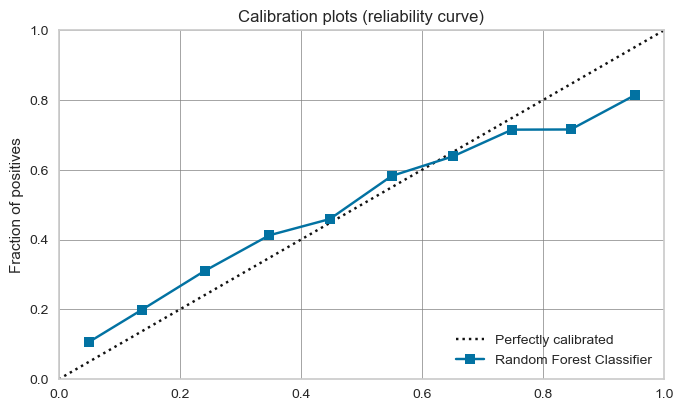

In [32]:
plot_model(calibrated_rf, plot='calibration')

In [33]:
calibrated_rf_isotonic = calibrate_model(rf, method = 'isotonic')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8095,0.7644,0.3209,0.6257,0.4242,0.3240,0.3500
1,0.8302,0.7644,0.3954,0.6970,0.5046,0.4114,0.4355
2,0.8177,0.7689,0.3181,0.6768,0.4327,0.3405,0.3751
3,0.8246,0.7648,0.3811,0.6751,0.4872,0.3911,0.4144
4,0.8183,0.7713,0.3324,0.6705,0.4444,0.3503,0.3812
5,0.8246,0.7768,0.3610,0.6885,0.4737,0.3805,0.4091
6,0.8183,0.7690,0.3467,0.6612,0.4549,0.3584,0.3853
7,0.8246,0.7515,0.3467,0.6994,0.4636,0.3727,0.4055
8,0.8127,0.7509,0.3410,0.6330,0.4432,0.3425,0.3663
9,0.8201,0.7636,0.3506,0.6667,0.4595,0.3638,0.3909


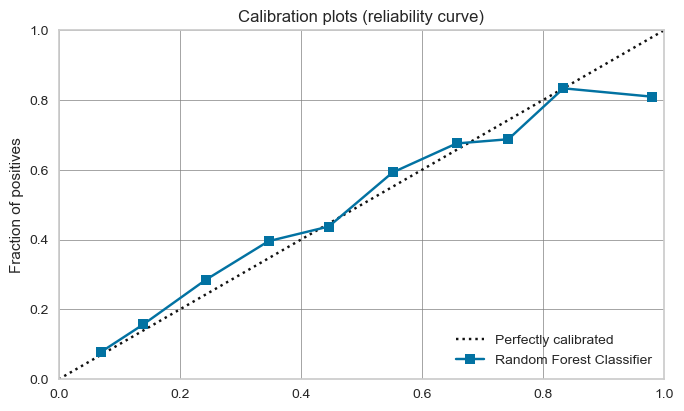

In [34]:
plot_model(calibrated_rf_isotonic, plot='calibration')